In [ ]:
%cd ..

/content/drive/MyDrive


In [1]:
# clone YOLOv5 repository
!git clone https://github.com/ultralytics/yolov5  # clone repo
%cd yolov5
!git reset --hard 064365d8683fd002e9ad789c1e91fa3d021b44f0

Cloning into 'yolov5'...
remote: Enumerating objects: 15814, done.
remote: Counting objects: 100% (45/45), done.
remote: Compressing objects: 100% (43/43), done.
remote: Total 15814 (delta 9), reused 26 (delta 2), pack-reused 15769
Receiving objects: 100% (15814/15814), 14.59 MiB | 15.76 MiB/s, done.
Resolving deltas: 100% (10823/10823), done.
/content/yolov5
HEAD is now at 064365d Update parse_opt() in export.py to work as in train.py (#10789)


In [2]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
%cd /content/drive/MyDrive/yolov5

/content/drive/MyDrive/yolov5


In [4]:
# install dependencies as necessary
!pip install -qr requirements.txt  # install dependencies (ignore errors)
import torch

from IPython.display import Image, clear_output  # to display images
from utils.downloads import attempt_download  # to download models/datasets

# clear_output()
print('Setup complete. Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 184.3/184.3 kB 16.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 10.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 86.2 MB/s eta 0:00:00
Setup complete. Using torch 2.0.1+cu118 _CudaDeviceProperties(name='Tesla T4', major=7, minor=5, total_memory=15101MB, multi_processor_count=40)


In [5]:
#follow the link below to get your download code from from Roboflow
!pip install -q roboflow
from roboflow import Roboflow
rf = Roboflow(api_key="901Flxpd8mV5hYR2xWuC", model_format="yolov5", notebook="roboflow-yolov5")

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.0/57.0 kB 5.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 155.3/155.3 kB 23.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 9.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.8/67.8 kB 9.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 55.6/55.6 kB 7.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 8.2 MB/s eta 0:00:00


In [ ]:
%cd /content/drive/MyDrive/yolov5
#after following the link above, recieve python code with these fields filled in
from roboflow import Roboflow
rf = Roboflow(api_key="901Flxpd8mV5hYR2xWuC")
project = rf.workspace("chess-pieces-detection").project("chess-pieces-detector-1001")
dataset = project.version(1).download("yolov5")

/content/drive/MyDrive/yolov5
loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to chess-pieces-detector-1001-1 in yolov5pytorch:: 100%|██████████| 1396/1396 [00:08<00:00, 170.62it/s]


In [8]:
!pwd

/content/drive/MyDrive/yolov5


In [9]:
!curl -L "https://public.roboflow.com/ds/SGbms2gJxJ?key=UR6OalWaZb" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   902  100   902    0     0   2809      0 --:--:-- --:--:-- --:--:--  2801
100 16.8M  100 16.8M    0     0  6861k      0  0:00:02  0:00:02 --:--:-- 13.1M
Archive:  roboflow.zip
replace README.dataset.txt? [y]es, [n]o, [A]ll, [N]one, [r]ename: A
 extracting: README.dataset.txt      
 extracting: README.roboflow.txt     
 extracting: data.yaml               
 extracting: test/images/0b47311f426ff926578c9d738d683e76_jpg.rf.40183eae584a653181bbd795ba3c353f.jpg  
 extracting: test/images/1c0060ef868bdc326ce5e6389cb6732f_jpg.rf.f02cd668d26a53d9bf001497992b3657.jpg  
 extracting: test/images/2f6fb003bb89cd401322a535acb42f65_jpg.rf.66c0a46773a9cd583fb96c3df41a9e0c.jpg  
 extracting: test/images/410993714e325a1de3e394ffe860df3a_jpg.rf.657c49ca295ef54da23469189070a075.jpg  
 extracting: test/images/4e3117459d759798537eb52cf5bf534d_jpg.r

In [10]:
# this is the YAML file Roboflow wrote for us that we're loading into this notebook with our data
%cat data.yaml

train: ../train/images
val: ../valid/images

nc: 13
names: ['bishop', 'black-bishop', 'black-king', 'black-knight', 'black-pawn', 'black-queen', 'black-rook', 'white-bishop', 'white-king', 'white-knight', 'white-pawn', 'white-queen', 'white-rook']

In [11]:
# define number of classes based on YAML
import yaml
with open("data.yaml", 'r') as stream:
    num_classes = str(yaml.safe_load(stream)['nc'])

In [12]:
#this is the model configuration we will use for our tutorial
%cat /content/drive/MyDrive/yolov5/models/yolov5s.yaml

# YOLOv5 🚀 by Ultralytics, GPL-3.0 license

# Parameters
nc: 80  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 v6.0 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Conv, [64, 6, 2, 2]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 6, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 3, C3, [1024]],
   [-1, 1, SPPF, [1024, 5]],  # 9
  ]

# YOLOv5 v6.0 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]]

In [13]:
#customize iPython writefile so we can write variables
from IPython.core.magic import register_line_cell_magic

@register_line_cell_magic
def writetemplate(line, cell):
    with open(line, 'w') as f:
        f.write(cell.format(**globals()))

In [ ]:
%%writetemplate /content/drive/MyDrive/yolov5/models/custom_yolov5s.yaml

# parameters
# This parameter represents the number of classes in your dataset. 
# You should set it according to the number of classes you have.
nc: {num_classes}  # number of classes
# This hyperparameter controls the depth of the model. 
# It is a multiplier that determines the number of layers in the network. 
# Decreasing it can make the model shallower, while increasing it can make the model deeper.
depth_multiple: 0.33  # model depth multiple
# This hyperparameter controls the width of the model. 
# It is a multiplier that determines the number of channels in each layer. 
# Decreasing it can reduce the model's capacity, while increasing it can increase the model's capacity.
width_multiple: 0.50  # layer channel multiple

# anchors
# defined for three different feature map scales: P3/8, P4/16, and P5/32.
# These scales correspond to the output of different layers in the YOLOv5 model.
# The "P" in "P3/8" stands for "Pyramid",
# and the number after the "P" indicates the level of the feature map pyramid. 
# The number after the slash ("/") indicates the stride of the feature map. 
# In the case of "P3/8", the feature map has a stride of 8 relative to the input image size.
#  This means that there are three anchor boxes for this scale, 
# with widths and heights of 10x13, 16x30, and 33x23 pixels, and aspect ratios
# The anchor boxes in YOLOv5 are determined by a k-means procedure, 
# looking at all the objects in the training set and clustering them based on their width and height
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
# The backbone network is responsible for extracting features 
# from the input image that can be used to detect objects. 
# the backbone network consists of a series of convolutional layers and 
# bottleneck blocks, with different scales and strides.
backbone:
  # [from, number, module, args]
  # Focus module with 64 filters and a kernel size of 3, 
  # and it operates on the input image at a scale of P1/2. 
  # purpose of the Focus module is to reduce the number of layers, 
  # parameters, FLOPS, and CUDA memory, while increasing the forward 
  # and backward speed, with minimal impact on mean average precision (mAP)
  # reduces the computational cost of the model 
  # The Focus module is a convolutional layer that uses a technique called channel-wise convolution 
  # to reduce the number of channels in the input image
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
  # convolutional layer with 128 filters, a kernel size of 3, and a stride of 2.
  # -1, indicates that the layer takes its input from the previous layer in the backbone network. 
  # 1, indicates that the layer has only one convolutional block.
  # purpose of this layer is to further reduce the size of the feature map output by the previous layer, 
  # while increasing the number of filters. This allows the backbone network to extract more complex features 
  # from the input image, which can improve the accuracy of the model for object detection tasks.
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
  # bottleneck block with a CSP (cross-stage partial) connection and 128 filters.
  # -1, indicates that the layer takes its input from the previous layer in the backbone network. 
  # 3, indicates that the layer has three convolutional blocks. 
  # bottleneck block with a CSP connection
  # purpose of the bottleneck block with a CSP connection is to improve the accuracy of the model 
  # while reducing the computational cost. The CSP connection allows the block to learn features 
  # from multiple scales of the feature map, which can improve the accuracy of the model for object
  # detection tasks. The bottleneck block reduces the number of filters in the feature map, 
  # which reduces the computational cost of the model while preserving the important features
   [-1, 3, BottleneckCSP, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, BottleneckCSP, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, BottleneckCSP, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   # SPP (Spatial Pyramid Pooling) layer with 1024 filters and a pyramid of pooling sizes.
   # 1024 is the number of filters in the block, and [5][9][13] is the pyramid of pooling sizes used in the block.
   # purpose of the SPP layer is to capture features at multiple scales in the input image, without increasing the 
   # number of parameters in the model. The SPP layer achieves this by applying max pooling at multiple scales to 
   # the input feature map, and concatenating the results. The pooling sizes in the pyramid are used to capture 
   # features at different scales in the input image
   [-1, 1, SPP, [1024, [5, 9, 13]]],
  # 'False' value in the notation indicates that the bottleneck block does not use a shortcut connection. 
  # A shortcut connection is a connection that bypasses one or more layers in the network, 
  # allowing the gradient to flow more easily during training. The use of shortcut connections 
  # can improve the accuracy of the model, but it also increases the computational cos
   [-1, 3, BottleneckCSP, [1024, False]],  # 9
  ]

# YOLOv5 head
# defines the architecture of the detection head used in the YOLOv5 model
# The detection head is responsible for predicting the bounding boxes, 
# objectness scores, and class probabilities for the objects in the input image.
# consists of a series of convolutional layers, upsampling layers, 
# concatenation layers, and bottleneck blocks, with different scales and strides. 
head:
  [[-1, 1, Conv, [512, 1, 1]],
  # None indicates that the size of the output tensor is not specified, 
  # 2 is the scale factor for upsampling, 
  # and 'nearest' is the interpolation method used for upsampling
  # purpose of the upsampling layer is to increase the resolution 
  # of the feature map output by the previous layer
  # This allows the detection head to detect smaller objects in the input image
  #  nearest interpolation method is used for upsampling, which means that the value of each pixel 
  # in the output tensor is determined by the value of the nearest pixel in the input tensor
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, BottleneckCSP, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   # upsampling layer that doubles the size of the feature map output by the previous layer
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, BottleneckCSP, [256, False]],  # 17 (P3/8-small)

   [-1, 1, Conv, [256, 3, 2]],
   [[-1, 14], 1, Concat, [1]],  # cat head P4
   [-1, 3, BottleneckCSP, [512, False]],  # 20 (P4/16-medium)

   [-1, 1, Conv, [512, 3, 2]],
   [[-1, 10], 1, Concat, [1]],  # cat head P5
   [-1, 3, BottleneckCSP, [1024, False]],  # 23 (P5/32-large)
   # detection layer that predicts the bounding boxes, objectness scores, 
   # and class probabilities for the objects in the input image. 
   # [17][20][23], indicates the indices of the feature maps from the backbone network 
   # that are used for object detection
   # the feature maps at scales P3, P4, and P5 are used for object detection
   # 1, indicates that the layer has only one detection block
   # nc is the number of classes to be detected, 
   # and anchors are the anchor boxes used for object detection.
   # The purpose of the detection layer is to predict the bounding boxes, 
   # objectness scores, and class probabilities for the objects in the input image. 
   # The detection layer achieves this by applying a series of convolutional filters 
   # to the feature maps from the backbone network, and then using these filters to 
   # predict the bounding boxes, objectness scores, and class probabilities for each 
   # object in the image
   [[17, 20, 23], 1, Detect, [nc, anchors]],  # Detect(P3, P4, P5)
  ]

In [15]:
# train yolov5s on custom data for 100 epochs
# time its performance
%%time
%cd /content/drive/MyDrive/yolov5
!python train.py --img 416 --batch 16 --epochs 100 --data /content/drive/MyDrive/yolov5/data.yaml --cfg ./models/custom_yolov5s.yaml --weights '' --name yolov5s_results  --cache

/content/drive/MyDrive/yolov5
2023-07-09 23:31:51.154426: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-07-09 23:31:52.003403: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
train: weights=, cfg=./models/custom_yolov5s.yaml, data=/content/drive/MyDrive/yolov5/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=100, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=yolov5s_results, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=

In [16]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

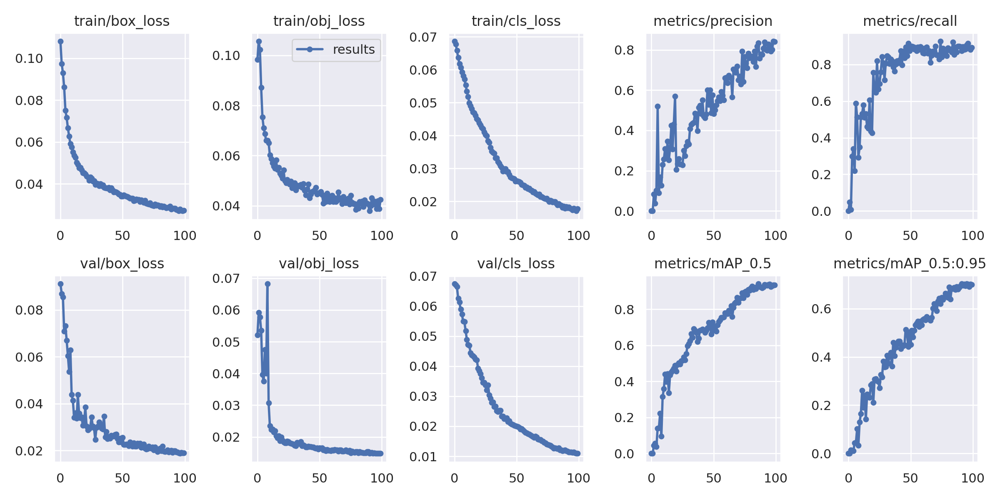

In [17]:
# we can also output some older school graphs if the tensor board isn't working for whatever reason...
from utils.plots import plot_results  # plot results.txt as results.png
Image(filename='/content/drive/MyDrive/yolov5/runs/train/yolov5s_results10/results.png', width=1000)  # view results.png

GROUND TRUTH TRAINING DATA:


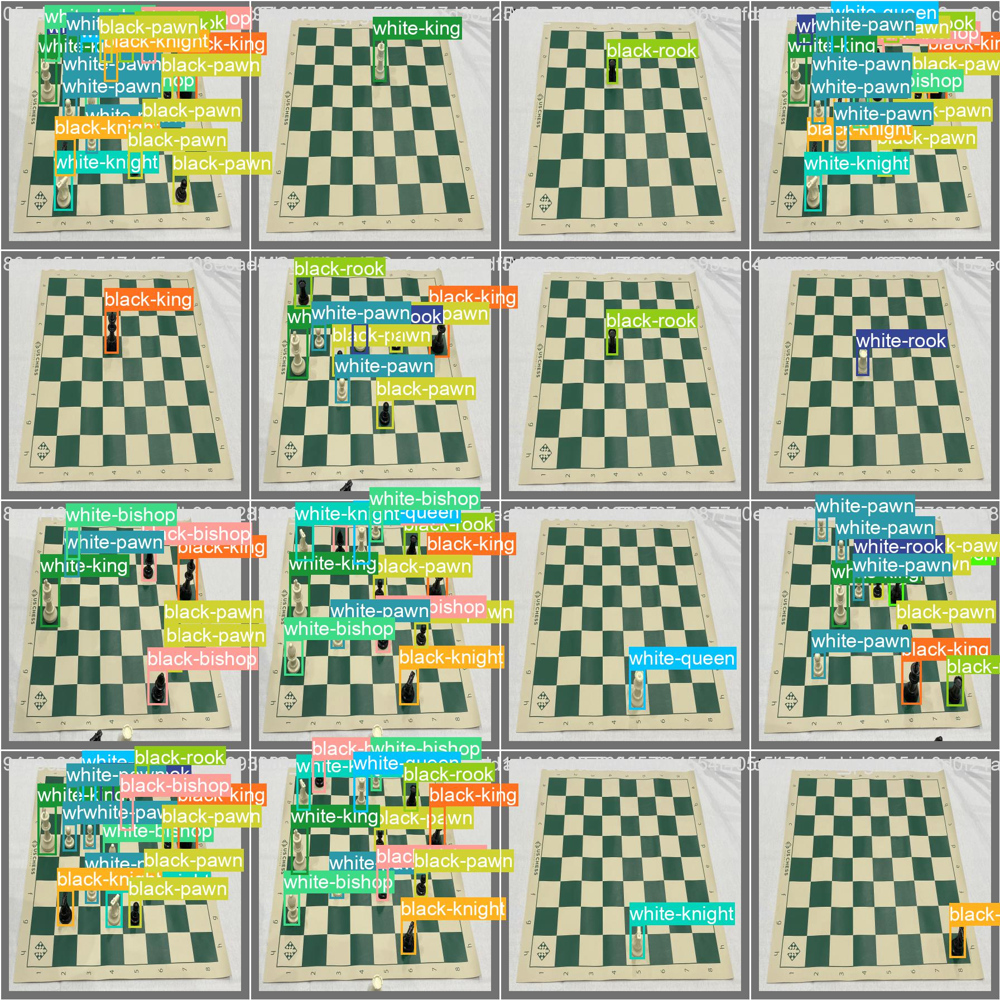

In [18]:
# first, display our ground truth data
print("GROUND TRUTH TRAINING DATA:")
Image(filename='/content/drive/MyDrive/yolov5/runs/train/yolov5s_results10/val_batch0_labels.jpg', width=900)

GROUND TRUTH AUGMENTED TRAINING DATA:


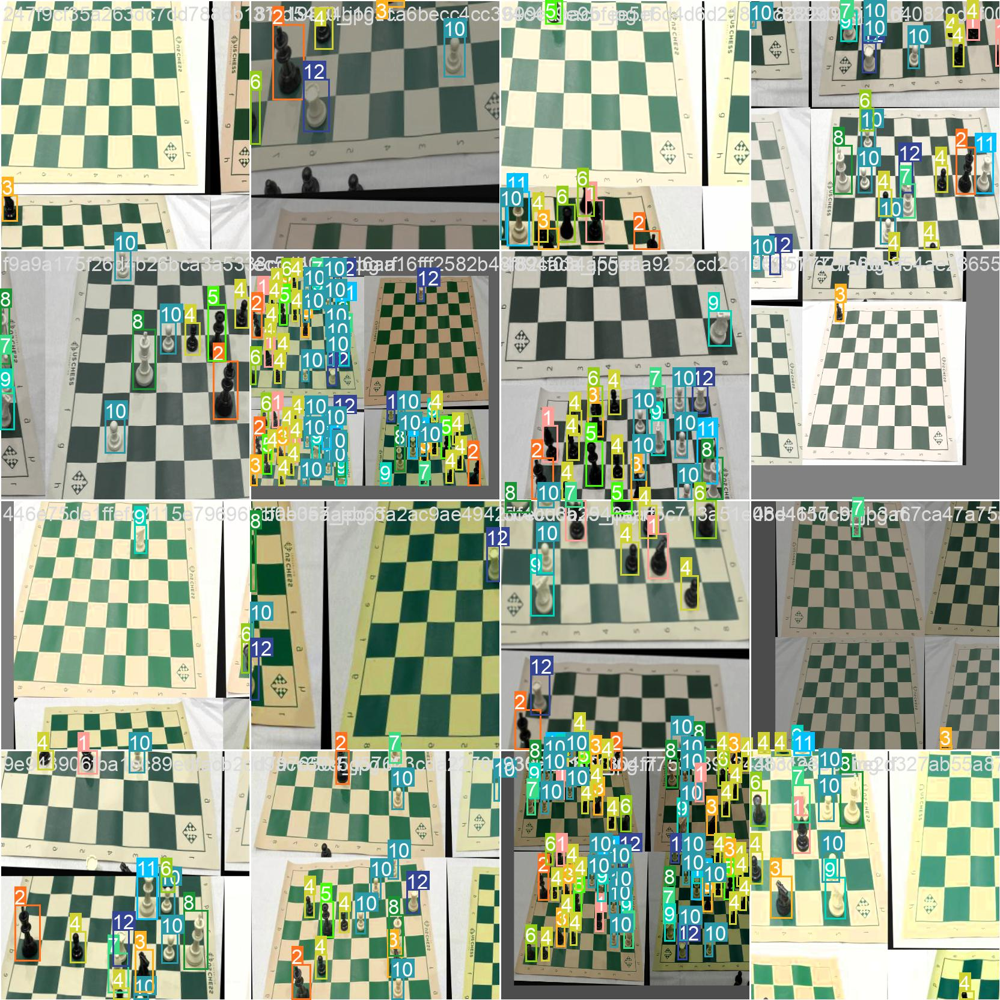

In [19]:
# print out an augmented training example
print("GROUND TRUTH AUGMENTED TRAINING DATA:")
Image(filename='/content/drive/MyDrive/yolov5/runs/train/yolov5s_results10/train_batch0.jpg', width=900)

In [20]:
# trained weights are saved by default in our weights folder
%ls runs/

detect/  train/


In [21]:
%ls runs/train/yolov5s_results10/weights

best.pt  last.pt


In [22]:
# when we ran this, we saw .007 second inference time. That is 140 FPS on a TESLA P100!
# use the best weights!
%cd /content/drive/MyDrive/yolov5
!python detect.py --weights runs/train/yolov5s_results10/weights/best.pt --img 416 --conf 0.4 --source /content/drive/MyDrive/yolov5/test/images --save-txt

/content/drive/MyDrive/yolov5
detect: weights=['runs/train/yolov5s_results10/weights/best.pt'], source=/content/drive/MyDrive/yolov5/test/images, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=True, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-72-g064365d Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
custom_YOLOv5s summary: 182 layers, 7278882 parameters, 0 gradients
image 1/29 /content/drive/MyDrive/yolov5/test/images/0b47311f426ff926578c9d738d683e76_jpg.rf.40183eae584a653181bbd795ba3c353f.jpg: 416x416 1 white-king, 9.1ms
image 2/29 /content/drive/MyDrive/yolov5/test/images/1c0060ef868bdc326ce5e6389cb6732f_jpg.rf.f02cd668d26a53d9bf001497992b3657.jp

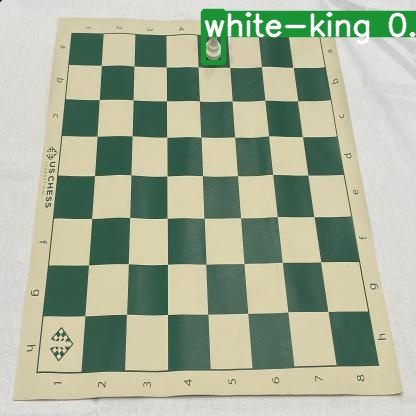

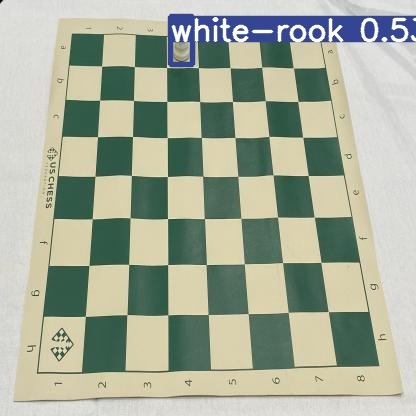

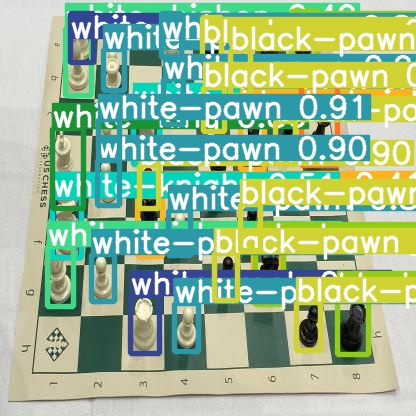

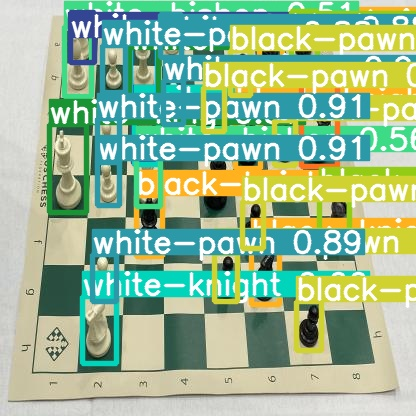

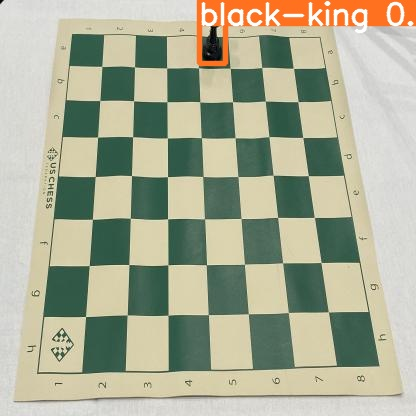

...

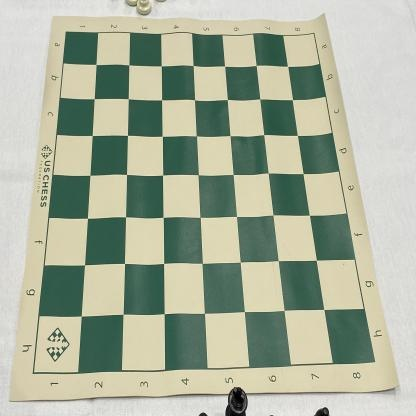

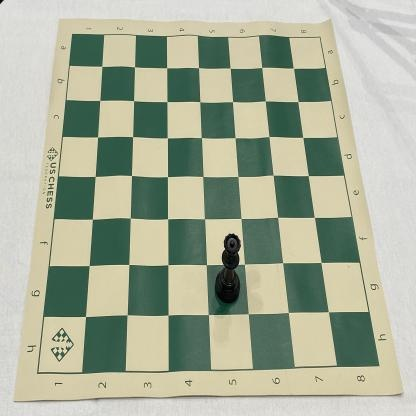

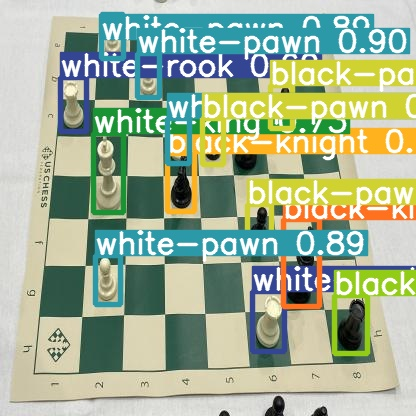

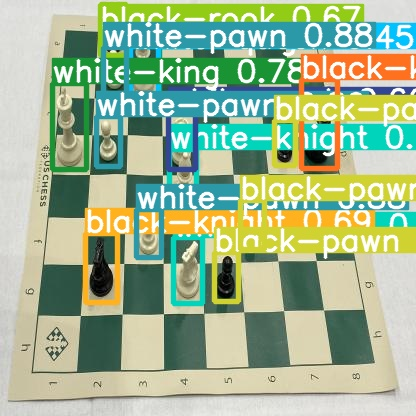

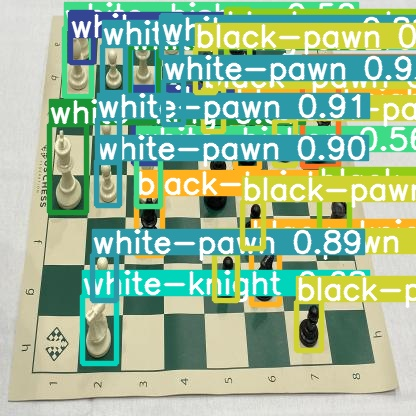

In [23]:
#display inference on ALL test images
#this looks much better with longer training above

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/drive/MyDrive/yolov5/runs/detect/exp12/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

In [27]:
!python val.py --weights /content/drive/MyDrive/yolov5/runs/train/yolov5s_results10/weights/best.pt --data /content/drive/MyDrive/yolov5/data.yaml --img 640


val: data=/content/drive/MyDrive/yolov5/data.yaml, weights=['/content/drive/MyDrive/yolov5/runs/train/yolov5s_results10/weights/best.pt'], batch_size=32, imgsz=640, conf_thres=0.001, iou_thres=0.6, max_det=300, task=val, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 v7.0-72-g064365d Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
custom_YOLOv5s summary: 182 layers, 7278882 parameters, 0 gradients
val: Scanning /content/drive/MyDrive/yolov5/valid/labels.cache... 58 images, 0 backgrounds, 0 corrupt: 100% 58/58 [00:00<?, ?it/s]
                 Class     Images  Instances          P          R      mAP50   mAP50-95: 100% 2/2 [00:03<00:00,  1.55s/it]
                   all         58        386      0.962      0.886       0.97      0.708
          black-bishop         58         22          1   

In [29]:
!python val.py --weights /content/drive/MyDrive/yolov5/runs/train/yolov5s_results10/weights/best.pt --data /content/drive/MyDrive/yolov5/data.yaml --img 640 --task 'train'

val: data=/content/drive/MyDrive/yolov5/data.yaml, weights=['/content/drive/MyDrive/yolov5/runs/train/yolov5s_results10/weights/best.pt'], batch_size=32, imgsz=640, conf_thres=0.001, iou_thres=0.6, max_det=300, task=train, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 v7.0-72-g064365d Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
custom_YOLOv5s summary: 182 layers, 7278882 parameters, 0 gradients
train: Scanning /content/drive/MyDrive/yolov5/train/labels.cache... 606 images, 0 backgrounds, 0 corrupt: 100% 606/606 [00:00<?, ?it/s]
train: WARNING ⚠️ /content/drive/MyDrive/yolov5/train/images/26d663ab5ffbec49f9dc8e592982cfd4_jpg.rf.0fe973299ff9e73874d9e684cba4e406.jpg: 1 duplicate labels removed
train: WARNING ⚠️ /content/drive/MyDrive/yolov5/train/images/26d663ab5ffbec49f9dc8e592982cfd4_jpg.

In [31]:
!python val.py --weights /content/drive/MyDrive/yolov5/runs/train/yolov5s_results10/weights/best.pt --data /content/drive/MyDrive/yolov5/data.yaml --img 640 --task 'test'

val: data=/content/drive/MyDrive/yolov5/data.yaml, weights=['/content/drive/MyDrive/yolov5/runs/train/yolov5s_results10/weights/best.pt'], batch_size=32, imgsz=640, conf_thres=0.001, iou_thres=0.6, max_det=300, task=test, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 v7.0-72-g064365d Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
custom_YOLOv5s summary: 182 layers, 7278882 parameters, 0 gradients
test: Scanning /content/drive/MyDrive/yolov5/test/labels... 29 images, 1 backgrounds, 0 corrupt: 100% 29/29 [00:00<00:00, 250.04it/s]
test: New cache created: /content/drive/MyDrive/yolov5/test/labels.cache
                 Class     Images  Instances          P          R      mAP50   mAP50-95: 100% 1/1 [00:01<00:00,  1.52s/it]
                   all         29        376      0.961      0.881    

In [32]:
# when we ran this, we saw .007 second inference time. That is 140 FPS on a TESLA P100!
# use the best weights!
%cd /content/drive/MyDrive/yolov5
!python detect.py --weights runs/train/yolov5s_results10/weights/best1010.pt --img 416 --conf 0.4 --source /content/drive/MyDrive/yolov5/test/images --save-txt

/content/drive/MyDrive/yolov5
detect: weights=['runs/train/yolov5s_results10/weights/best1010.pt'], source=/content/drive/MyDrive/yolov5/test/images, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=True, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-72-g064365d Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
YOLOv5s summary: 213 layers, 7045186 parameters, 0 gradients, 15.9 GFLOPs
image 1/29 /content/drive/MyDrive/yolov5/test/images/0b47311f426ff926578c9d738d683e76_jpg.rf.40183eae584a653181bbd795ba3c353f.jpg: 416x416 1 white-bishop, 7.5ms
image 2/29 /content/drive/MyDrive/yolov5/test/images/1c0060ef868bdc326ce5e6389cb6732f_jpg.rf.f02cd668d26a53d9bf00149

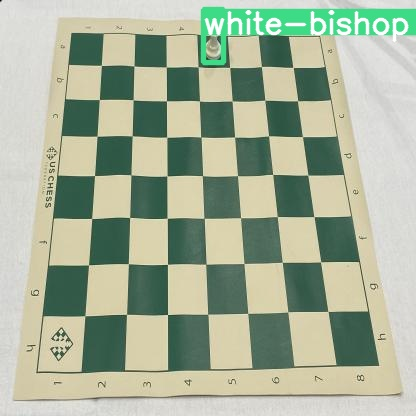

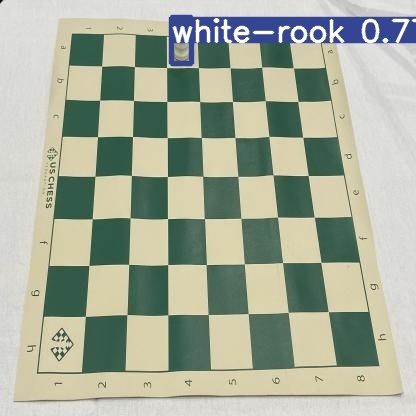

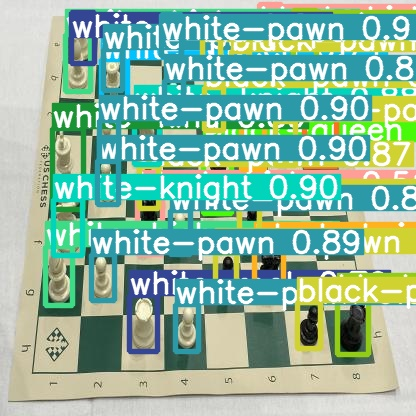

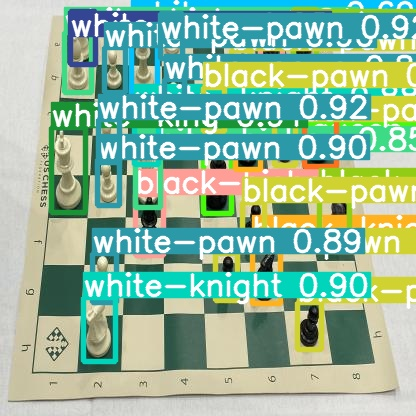

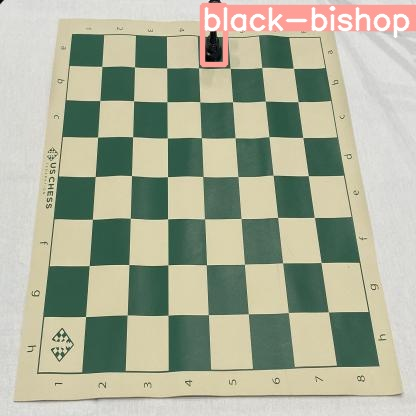

...

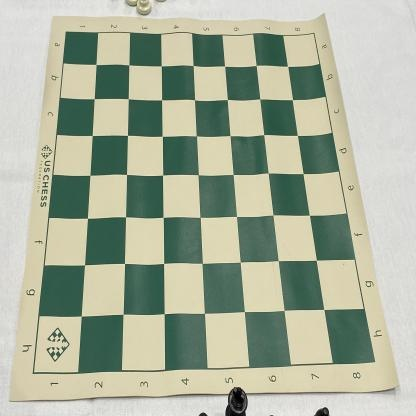

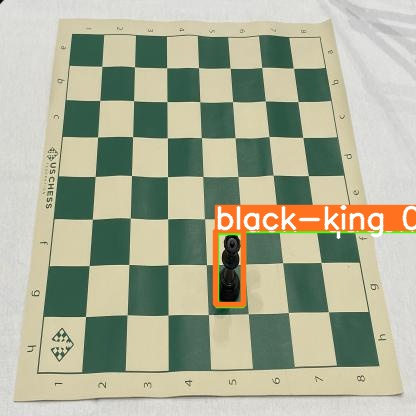

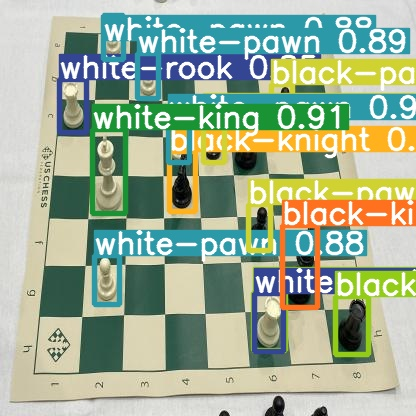

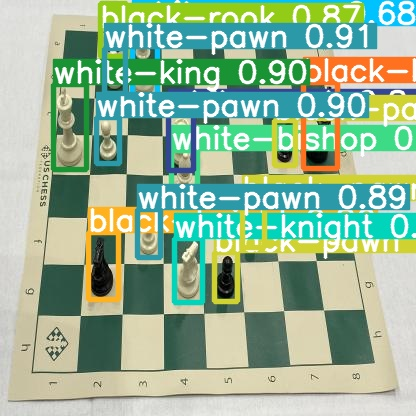

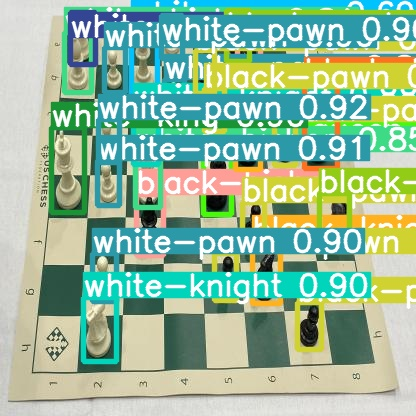

In [33]:
#display inference on ALL test images
#this looks much better with longer training above

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/drive/MyDrive/yolov5/runs/detect/exp13/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

In [34]:
!python val.py --weights /content/drive/MyDrive/yolov5/runs/train/yolov5s_results10/weights/best1010.pt --data /content/drive/MyDrive/yolov5/data.yaml --img 640

val: data=/content/drive/MyDrive/yolov5/data.yaml, weights=['/content/drive/MyDrive/yolov5/runs/train/yolov5s_results10/weights/best1010.pt'], batch_size=32, imgsz=640, conf_thres=0.001, iou_thres=0.6, max_det=300, task=val, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 v7.0-72-g064365d Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
YOLOv5s summary: 213 layers, 7045186 parameters, 0 gradients, 15.9 GFLOPs
val: Scanning /content/drive/MyDrive/yolov5/valid/labels.cache... 58 images, 0 backgrounds, 0 corrupt: 100% 58/58 [00:00<?, ?it/s]
                 Class     Images  Instances          P          R      mAP50   mAP50-95: 100% 2/2 [00:02<00:00,  1.48s/it]
                   all         58        386      0.958      0.984      0.986      0.757
          black-bishop         58         22    

In [36]:
!python val.py --weights /content/drive/MyDrive/yolov5/runs/train/yolov5s_results10/weights/best1010.pt --data /content/drive/MyDrive/yolov5/data.yaml --img 640 --task 'train'

val: data=/content/drive/MyDrive/yolov5/data.yaml, weights=['/content/drive/MyDrive/yolov5/runs/train/yolov5s_results10/weights/best1010.pt'], batch_size=32, imgsz=640, conf_thres=0.001, iou_thres=0.6, max_det=300, task=train, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 v7.0-72-g064365d Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
YOLOv5s summary: 213 layers, 7045186 parameters, 0 gradients, 15.9 GFLOPs
train: Scanning /content/drive/MyDrive/yolov5/train/labels.cache... 606 images, 0 backgrounds, 0 corrupt: 100% 606/606 [00:00<?, ?it/s]
train: WARNING ⚠️ /content/drive/MyDrive/yolov5/train/images/26d663ab5ffbec49f9dc8e592982cfd4_jpg.rf.0fe973299ff9e73874d9e684cba4e406.jpg: 1 duplicate labels removed
train: WARNING ⚠️ /content/drive/MyDrive/yolov5/train/images/26d663ab5ffbec49f9dc8e59298

In [37]:
!python val.py --weights /content/drive/MyDrive/yolov5/runs/train/yolov5s_results10/weights/best1010.pt --data /content/drive/MyDrive/yolov5/data.yaml --img 640 --task 'test'

val: data=/content/drive/MyDrive/yolov5/data.yaml, weights=['/content/drive/MyDrive/yolov5/runs/train/yolov5s_results10/weights/best1010.pt'], batch_size=32, imgsz=640, conf_thres=0.001, iou_thres=0.6, max_det=300, task=test, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 v7.0-72-g064365d Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
YOLOv5s summary: 213 layers, 7045186 parameters, 0 gradients, 15.9 GFLOPs
test: Scanning /content/drive/MyDrive/yolov5/test/labels.cache... 29 images, 1 backgrounds, 0 corrupt: 100% 29/29 [00:00<?, ?it/s]
                 Class     Images  Instances          P          R      mAP50   mAP50-95: 100% 1/1 [00:02<00:00,  2.45s/it]
                   all         29        376      0.956      0.982      0.984       0.77
          black-bishop         29         21   